In [113]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/arcface-weights/ms1mv3_arcface_r50_fp16.pth
/kaggle/input/style-gan-data/editing/editing/pose.pt
/kaggle/input/style-gan-data/editing/editing/smile.pt
/kaggle/input/style-gan-data/editing/editing/age.pt
/kaggle/input/style-gan-data/celebs/celebs/Stethem/1646466328_27-damion-club-p-dzheison-stetkhem-art-29.jpg
/kaggle/input/style-gan-data/celebs/celebs/Stethem/stethem6.jpg
/kaggle/input/style-gan-data/celebs/celebs/Stethem/24108-djeyson_stethem.jpg
/kaggle/input/style-gan-data/celebs/celebs/Stethem/stethem2.jpg
/kaggle/input/style-gan-data/celebs/celebs/Stethem/stethem7.jpg
/kaggle/input/style-gan-data/celebs/celebs/KJunJin/yunjin-foto-6.jpg
/kaggle/input/style-gan-data/celebs/celebs/KJunJin/1603911307_16-p-kim-yundzhin-43.jpg
/kaggle/input/style-gan-data/celebs/celebs/KJunJin/86.jpg
/kaggle/input/style-gan-data/celebs/celebs/KJunJin/filmz.ru_f_178613.jpg
/kaggle/input/style-gan-data/celebs/celebs/KJunJin/yunjin-foto-2-scaled.jpg
/kaggle/input/style-gan-data/celebs/celebs/

In [114]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [115]:
!pip install ninja
!pip install imageio-ffmpeg
!pip install -U -q PyDrive
!pip install lpips
!pip install pytorch_msssim
!pip install pytorch-ignite

In [116]:
import pickle
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

import PIL
import os
import numpy as np
import torch
import lpips
import torch.nn as nn
import torchvision.transforms as transforms
from pytorch_msssim import ms_ssim
from tqdm import tqdm
import torch.nn.functional as F

In [117]:
!pip install dlib
# !pip install '/kaggle/input/dlibpkg/dlib-19.19.0'

In [118]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch
%cd stylegan2-ada-pytorch
!git clone https://github.com/denkogit/stylegan2_models

fatal: destination path 'stylegan2-ada-pytorch' already exists and is not an empty directory.
/kaggle/working/stylegan2-ada-pytorch/stylegan2-ada-pytorch
fatal: destination path 'stylegan2_models' already exists and is not an empty directory.


In [119]:
!wget https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl

--2024-03-24 11:35:24--  https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl
Resolving nvlabs-fi-cdn.nvidia.com (nvlabs-fi-cdn.nvidia.com)... 3.163.158.75, 3.163.158.34, 3.163.158.113, ...
Connecting to nvlabs-fi-cdn.nvidia.com (nvlabs-fi-cdn.nvidia.com)|3.163.158.75|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 381624121 (364M) [binary/octet-stream]
Saving to: 'ffhq.pkl.1'

ffhq.pkl.1          100%[===================>] 363.94M   246MB/s    in 1.5s    

2024-03-24 11:35:26 (246 MB/s) - 'ffhq.pkl.1' saved [381624121/381624121]



In [120]:
!wget https://github.com/davisking/dlib-models/raw/master/shape_predictor_68_face_landmarks.dat.bz2

--2024-03-24 11:35:27--  https://github.com/davisking/dlib-models/raw/master/shape_predictor_68_face_landmarks.dat.bz2
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/davisking/dlib-models/master/shape_predictor_68_face_landmarks.dat.bz2 [following]
--2024-03-24 11:35:27--  https://raw.githubusercontent.com/davisking/dlib-models/master/shape_predictor_68_face_landmarks.dat.bz2
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M) [application/octet-stream]
Saving to: 'shape_predictor_68_face_landmarks.dat.bz2.1'

shape_predictor_68_ 100%[===================>]  61.07M   256MB/s    in

In [121]:
!bzip2 -d /kaggle/working/shape_predictor_68_face_landmarks.dat.bz2

bzip2: Can't open input file /kaggle/working/shape_predictor_68_face_landmarks.dat.bz2: No such file or directory.


In [122]:
# %cd stylegan2-ada-pytorch
!git clone https://github.com/denkogit/stylegan2_models

fatal: destination path 'stylegan2_models' already exists and is not an empty directory.


In [123]:
# import os
# from stylegan2_models.image_aligner.face_alignment import image_align
# from stylegan2_models.image_aligner.landmarks_detector import LandmarksDetector


# landmarks_model_path = "/kaggle/working/shape_predictor_68_face_landmarks.dat"
# RAW_IMAGES_DIR = "/kaggle/input/style-gan-data/celebs/celebs"
# ALIGNED_IMAGES_DIR = "/kaggle/working/aligned"

# landmarks_detector = LandmarksDetector(landmarks_model_path)
# for celeb in os.listdir(RAW_IMAGES_DIR):
#     celeb_folder = os.path.join(RAW_IMAGES_DIR, celeb)
#     save_path = os.path.join(ALIGNED_IMAGES_DIR, celeb)
#     os.makedirs(save_path, exist_ok=True)
#     for i, img_name in enumerate(os.listdir(celeb_folder)):
#         if not img_name.endswith(".jpg"):
#             continue
#         raw_img_path = os.path.join(celeb_folder, img_name)
#         for face_landmarks in landmarks_detector.get_landmarks(raw_img_path):
#             aligned_face_path = os.path.join(save_path, f"{i}.jpg")
#             image_align(raw_img_path, aligned_face_path, face_landmarks)
#             break


In [124]:
from glob import glob

In [125]:
# !mkdir aligned/expressions

In [126]:
# save_path = "aligned/expressions"
# for path in glob("/kaggle/input/styles-expressions/expressions/expressions/*.jpg"):
#     for face_landmarks in landmarks_detector.get_landmarks(path):
#         aligned_face_path = f'{save_path}/{path.split("/")[-1]}'
        
#         image_align(path, aligned_face_path, face_landmarks)
#         break

In [127]:
# !zip -r aligned.zip aligned

In [128]:
# image = ((image * std) + mean)
def plot_image(tensor, plot_size=(10,10)):
    tensor = (tensor.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    img = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
    plt.rcParams["figure.figsize"] = plot_size
    plt.imshow(img)


def broadcast_w_sg(w_batch, cast_n=18):
    input_ws = []
    for w in w_batch:
        w_broadcast = torch.broadcast_to(w, (cast_n, 512))
        input_ws.append(w_broadcast)
    return torch.stack(input_ws)


In [129]:
import os
os.chdir("/kaggle/working/stylegan2-ada-pytorch")
print(os.getcwd())

seed = 2345645
noise_mode = 'const' # шум
label = 0 # для разных моделей
device = "cuda:0"
model_path = "/kaggle/working/ffhq.pkl"

with open(model_path, 'rb') as f:
    G = pickle.load(f)['G_ema'].cuda()

/kaggle/working/stylegan2-ada-pytorch


In [14]:
# https://pypi.org/project/pytorch-msssim/
class Rec_loss(nn.Module):
    def __init__(self):
        super().__init__()
        self.l1_criterion = torch.nn.L1Loss(reduction='mean')

    def forward(self, target, synth):
        target = torch.add(target, 1.0)
        target = torch.mul(target, 127.5)
        target = target / 255

        synth = torch.add(synth, 1.0)
        synth = torch.mul(synth, 127.5)
        synth = synth / 255

        loss = torch.mean(1 - ms_ssim(synth, target, data_range=1, size_average=True))
        return loss

# https://pypi.org/project/lpips/
class Lpips_loss(nn.Module):
    def __init__(self, device):
        super().__init__()
        self.lpips_loss = lpips.LPIPS(net='vgg')
        self.lpips_loss.to(device)
        self.lpips_loss.eval()

    def forward(self, target, synth):
        return torch.mean(self.lpips_loss(target, synth))

# https://github.com/NVlabs/stylegan2-ada-pytorch/blob/main/projector.py#L104
class Reg_loss(nn.Module):
    def __init__(self, noise_bufs):
        super().__init__()
        self.noise_bufs = noise_bufs

    def forward(self,):
        reg_loss = 0.0
        for v in self.noise_bufs.values():
            noise = v[None,None,:,:] # must be [1,1,H,W] for F.avg_pool2d()
            while True:
                reg_loss += (noise*torch.roll(noise, shifts=1, dims=3)).mean()**2
                reg_loss += (noise*torch.roll(noise, shifts=1, dims=2)).mean()**2
                if noise.shape[2] <= 8:
                    break
                noise = F.avg_pool2d(noise, kernel_size=2)
        return reg_loss

# image = (image - mean) / std
def image2tensor_norm(image):
    transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    tensor = transform(image)
    return tensor

In [15]:
# я искал стили, но не нашел за определенное время
# для экономии ресурсов, написал генератор новых цветов
# так получились еще стили :) 

def change_color_palette(image_array, target_hue):
    hsv_image = Image.fromarray(image_array, 'RGB').convert('HSV')
    hsv_array = np.array(hsv_image)
    
    hsv_array[:, :, 0] = target_hue
    
    new_image = Image.fromarray(hsv_array, 'HSV').convert('RGB')

    return new_image

# blue_style = change_color_palette(og_style, 120)

In [16]:
def interpolate(latent1, latent2, psi=0.5, indeces=[i for i in range(0,18)]):
    init_latent = latent1.clone()
    latent1 = latent1.clone()
    latent2 = latent2.clone()
    for i in indeces:
        latent1[:, i] = latent2[:, i].lerp(latent1[:, i], psi)

    edited_tensor = G.synthesis(latent1, noise_mode='const', force_fp32=True)
    init_tensor = G.synthesis(init_latent, noise_mode='const', force_fp32=True)
    plot_image(torch.cat((init_tensor, edited_tensor ), dim=3), (10,10))

In [90]:
def fit_latent(target_pil):
    if target_pil.size != (1024, 1024):
        target_pil = target_pil.resize((1024, 1024))
    target_tensor = image2tensor_norm(target_pil).to(device).unsqueeze(0)

    # инициализируем функции потерь
    lpips_loss = Lpips_loss(device)
    rec_loss = Rec_loss()

    noise_bufs = { name: buf for (name, buf) in G.synthesis.named_buffers() if 'noise_const' in name }
    reg_loss = Reg_loss(noise_bufs)

    #  loss weights
    regularize_noise_weight = 5e5
    rec_weight = 0.5
    lpips_weoght = 1

    # Параметры для оптимизации
    num_steps = 120
    seed = 42
    initial_learning_rate = 0.05
    w_avg_samples = 10000

    # Получаем средний вектор латентного пространства
    z_samples = torch.from_numpy(np.random.RandomState(seed).randn(w_avg_samples, G.z_dim)).to(device)
    w_samples = G.mapping(z_samples, None)
    w_samples = w_samples[:, :1, :].cpu().numpy().astype(np.float32)
    w_avg = np.mean(w_samples, axis=0, keepdims=True)   # [1, 1, C]
    w_std = (np.sum((w_samples - w_avg) ** 2) / w_avg_samples) ** 0.5

    w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=False) # pylint: disable=not-callable
    w_opt = broadcast_w_sg(w_opt).requires_grad_(True)

    optimizer = torch.optim.Adam([w_opt], lr=initial_learning_rate)
    scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.99)

    generated_tensors = []
    for step in tqdm(range(num_steps)):
        synth_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const')

        lpips_value = lpips_loss(synth_tensor, target_tensor)
        rec_value = rec_loss(synth_tensor, target_tensor)
        reg_value = reg_loss()

        loss = lpips_value*lpips_weoght + rec_value*rec_weight + reg_value*regularize_noise_weight

        optimizer.step()
        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        scheduler.step()

    return w_opt

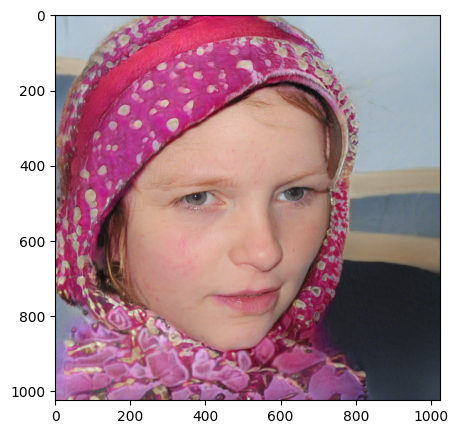

In [130]:
z = torch.from_numpy(np.random.RandomState(seed).randn(1, G.z_dim)).to(device)
ws = G.mapping(z, label)

generated_tensor = G.synthesis(ws, noise_mode=noise_mode, force_fp32=True)
plot_image(generated_tensor, (5,5))

# Style transfer 

In [21]:
SAVE_ROOT = "/kaggle/working/out"
STYLE_ROOT = '/kaggle/input/styles-expressions/styles/styles/'

In [ ]:
!mkdir /kaggle/working/out
!mkdir /kaggle/working/out/styles

In [18]:
initial_style = fit_latent(Image.open('/kaggle/input/aligned-data/aligned/Stethem/3.jpg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 164MB/s]  


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth
Setting up PyTorch plugin "bias_act_plugin"... Done.


  0%|          | 0/120 [00:00<?, ?it/s]

Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


100%|██████████| 120/120 [01:06<00:00,  1.80it/s]


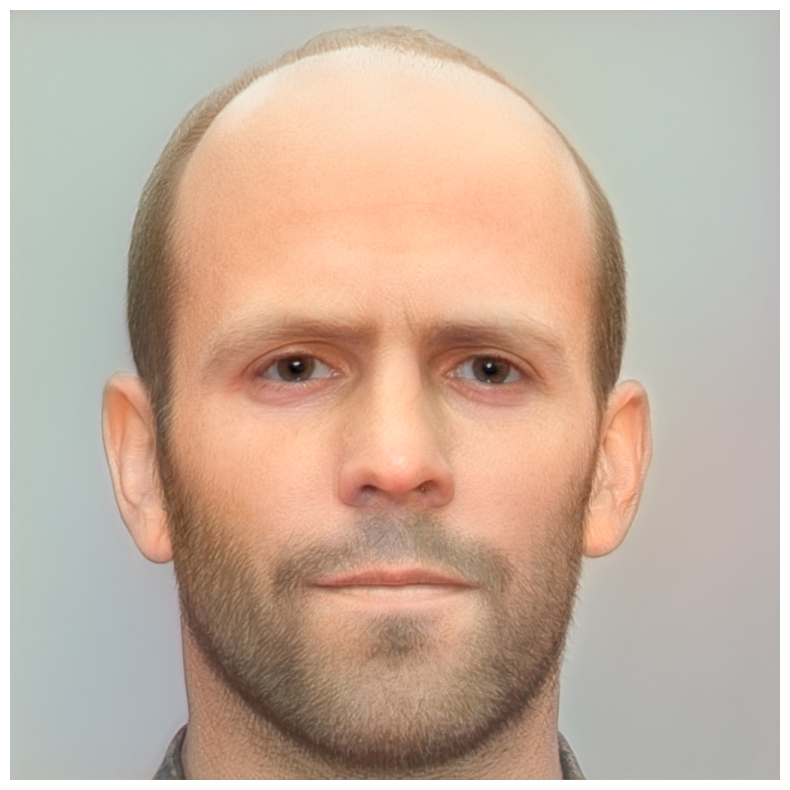

In [22]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(initial_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/init_style.jpg")

In [ ]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(initial_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/init_style.jpg")

In [74]:
green_style = fit_latent(Image.open(f'{STYLE_ROOT}/green_style.jpeg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 176MB/s]  


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:43<00:00,  2.73it/s]


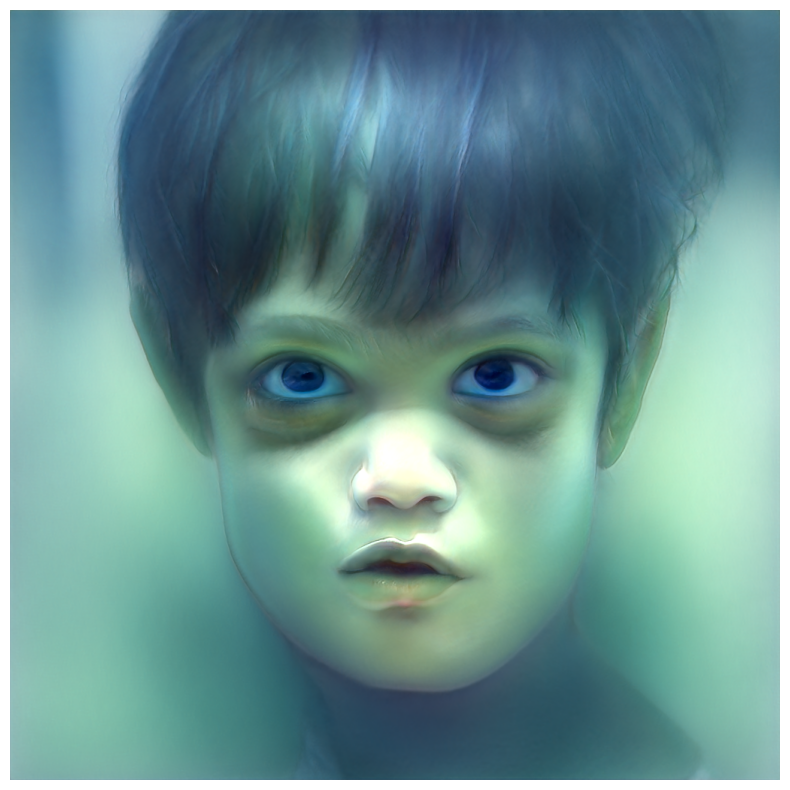

In [78]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(green_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/green_style.jpg")

In [80]:
bad_trip1 = Image.open(f'/kaggle/input/bad-trip-styles/bad_trip1.jpeg').convert('RGB')

In [85]:
bad_trip1_style = fit_latent(Image.open(f'/kaggle/input/bad-trip-styles/bad_trip1.jpeg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.83it/s]


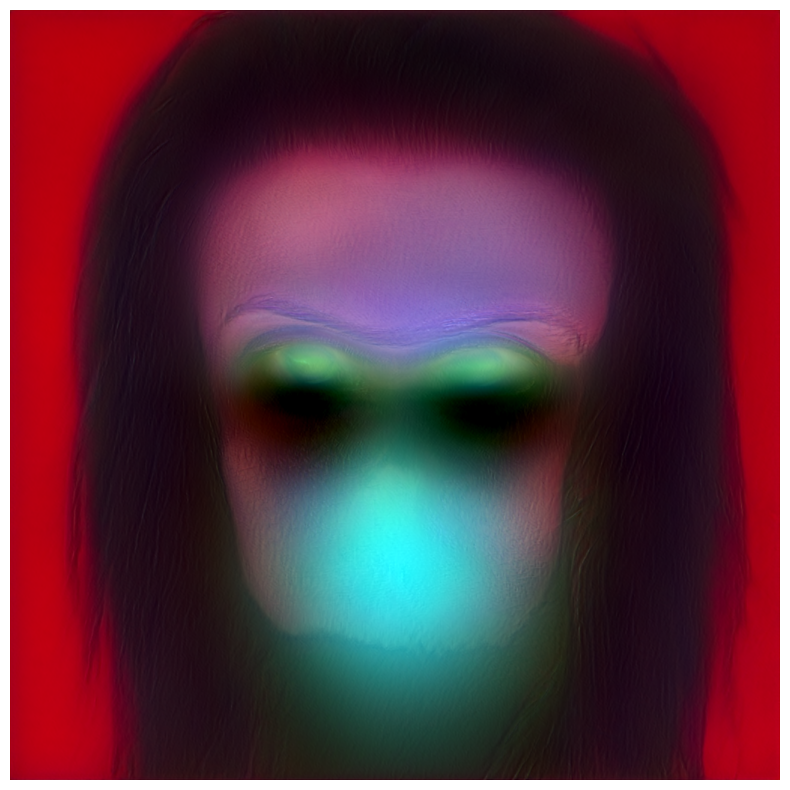

In [94]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(bad_trip1_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/bad_trip1_style.jpg")

In [95]:
bad_trip2_style = fit_latent(Image.open(f'/kaggle/input/bad-trip-styles/bad_trip2.jpeg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.85it/s]


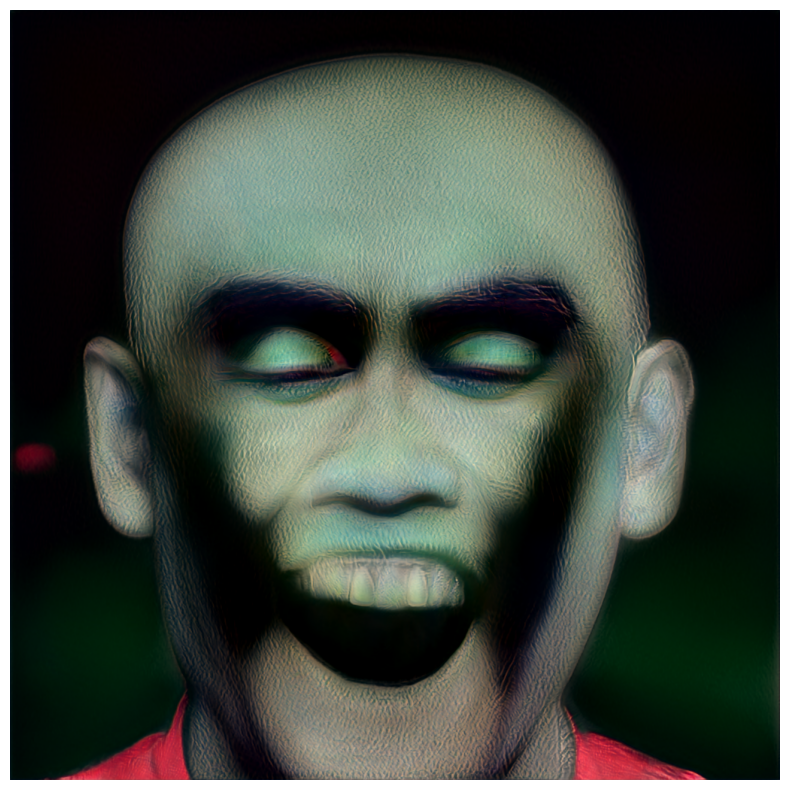

In [97]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(bad_trip2_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/bad_trip2_style.jpg")

In [99]:
pink_style = fit_latent(Image.open(f'{STYLE_ROOT}/blue_variant.jpeg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.84it/s]


In [143]:
# !zip -r /kaggle/working/out.zip /kaggle/working/out/*

updating: kaggle/working/out/expressions/ (stored 0%)
updating: kaggle/working/out/expressions/transfered_happy.jpg (deflated 17%)
updating: kaggle/working/out/expressions/neutral.jpg (deflated 16%)
updating: kaggle/working/out/expressions/transfered_fear_failed.jpg (deflated 31%)
updating: kaggle/working/out/expressions/sad.jpg (deflated 11%)
updating: kaggle/working/out/expressions/transfered_sad.jpg (deflated 16%)
updating: kaggle/working/out/expressions/happy.jpg (deflated 14%)
updating: kaggle/working/out/expressions/transfered_fear_succsess.jpg (deflated 32%)
updating: kaggle/working/out/expressions/fear.jpg (deflated 19%)
updating: kaggle/working/out/expressions/transfered_fear.jpg (deflated 12%)
updating: kaggle/working/out/init_style.jpg (deflated 16%)
updating: kaggle/working/out/styles/ (stored 0%)
updating: kaggle/working/out/styles/transfered_green.jpg (deflated 31%)
updating: kaggle/working/out/styles/transfered_pink.jpg (deflated 32%)
updating: kaggle/working/out/styles/

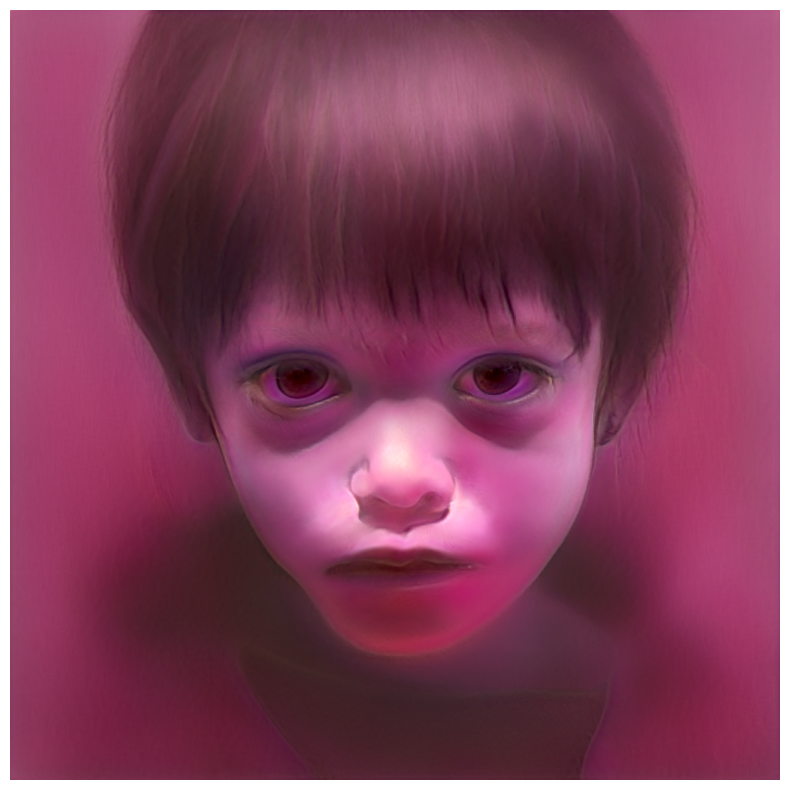

In [102]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(pink_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/pink_style.jpg")

In [107]:
bad_trip3_style = fit_latent(Image.open(f'/kaggle/input/bad-trip-styles/bad_trip3.jpeg').convert('RGB'))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.85it/s]


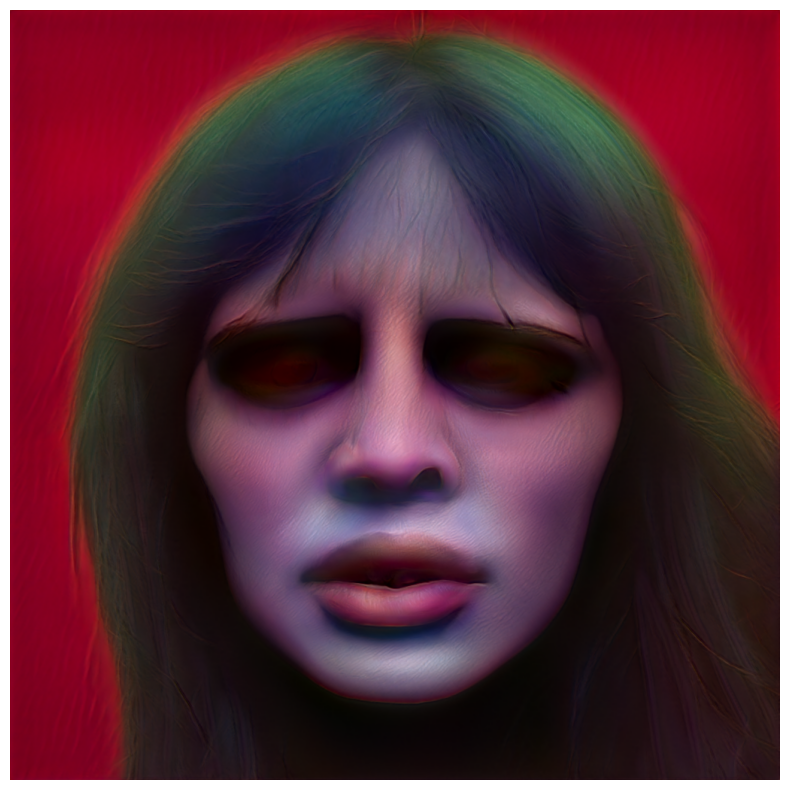

In [108]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(bad_trip3_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/styles/bad_trip3_style.jpg")

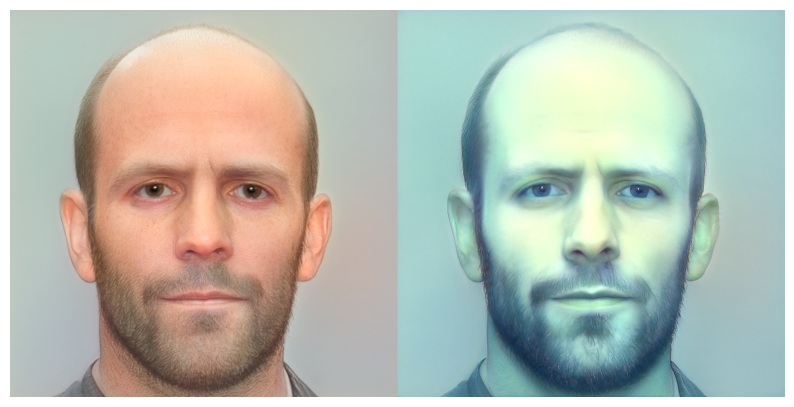

In [103]:
plt.figure()
plt.axis('off')
interpolate(initial_style, green_style, 0, list(range(9, 18)))
plt.savefig(f"{SAVE_ROOT}/styles/transfered_green.jpg")

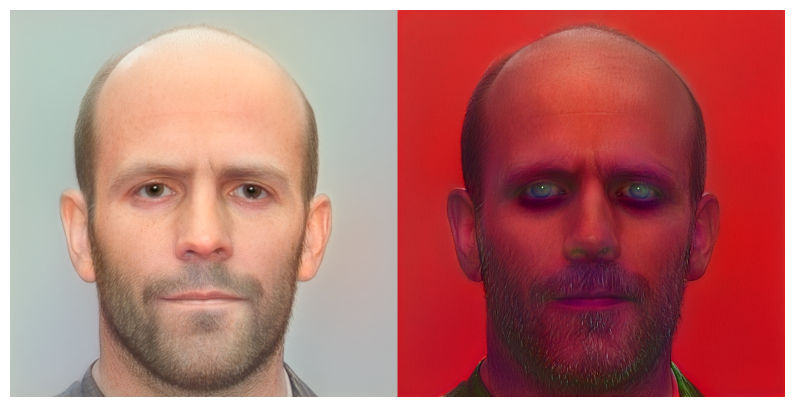

In [104]:
plt.figure()
plt.axis('off')
interpolate(initial_style, bad_trip1_style, 0, list(range(9, 18)))
plt.savefig(f"{SAVE_ROOT}/styles/transfered_bad_trip1.jpg")

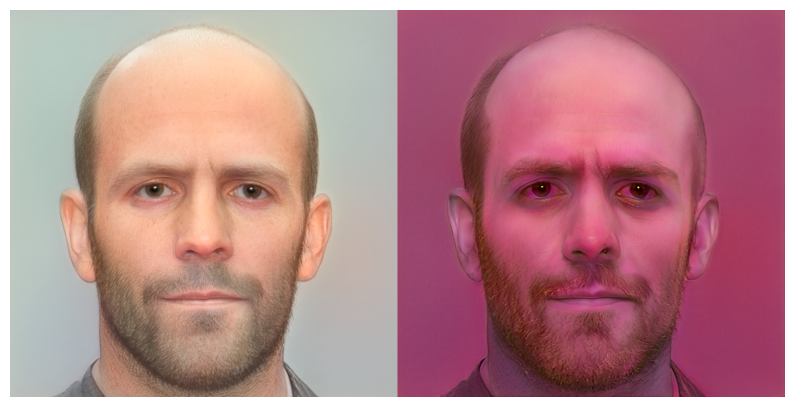

In [105]:
plt.figure()
plt.axis('off')
interpolate(initial_style, pink_style, 0, list(range(9, 18)))
plt.savefig(f"{SAVE_ROOT}/styles/transfered_pink.jpg")

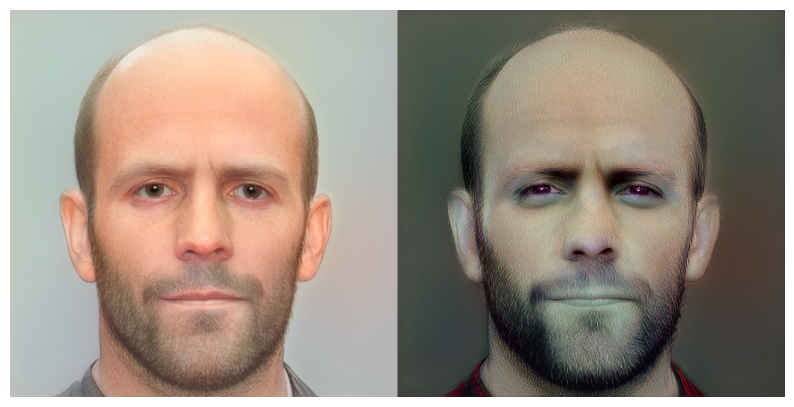

In [106]:
plt.figure()
plt.axis('off')
interpolate(initial_style, bad_trip2_style, 0, list(range(9, 18)))
plt.savefig(f"{SAVE_ROOT}/styles/transfered_bad_trip2.jpg")

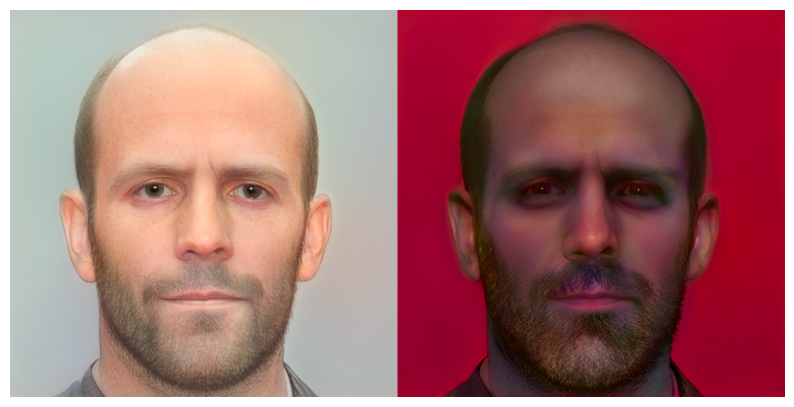

In [112]:
plt.figure()
plt.axis('off')
interpolate(initial_style, bad_trip3_style, 0, list(range(9, 18)))
plt.savefig(f"{SAVE_ROOT}/styles/transfered_bad_trip3.jpg")

# Expression transfer

In [33]:
EXPRESSIONS_ROOT = "/kaggle/working/aligned/expressions"

In [115]:
!mkdir /kaggle/working/out/expressions

mkdir: cannot create directory '/kaggle/working/out/expressions': File exists


In [34]:
neutral_style = fit_latent(Image.open(f'{EXPRESSIONS_ROOT}/Neutral.jpg').convert('RGB'))

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.83it/s]


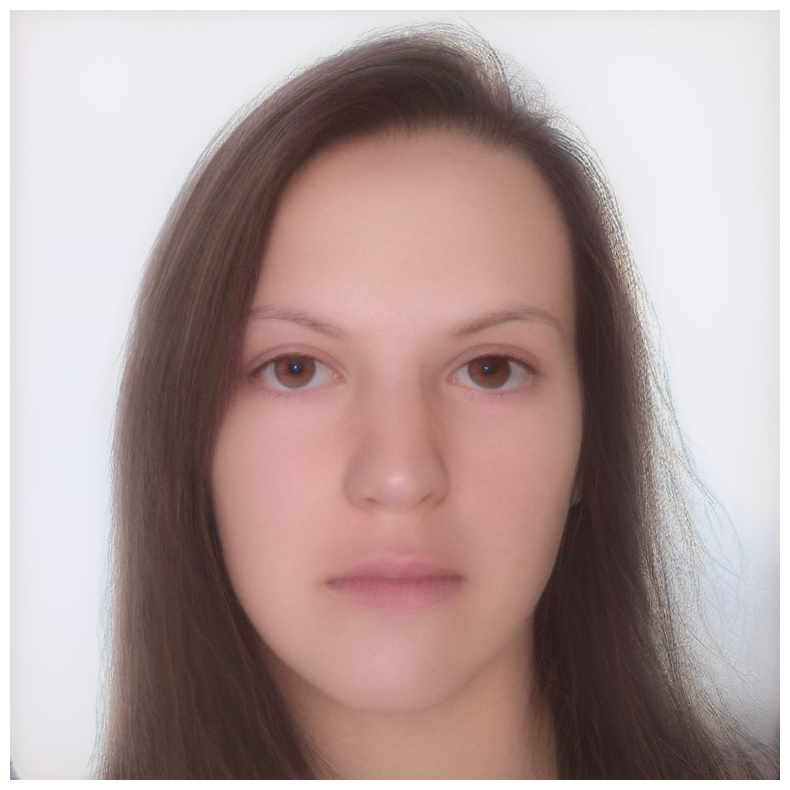

In [117]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(neutral_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/neutral.jpg")

In [35]:
happy_style = fit_latent(Image.open(f'{EXPRESSIONS_ROOT}/Happy.jpg').convert('RGB'))

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.82it/s]


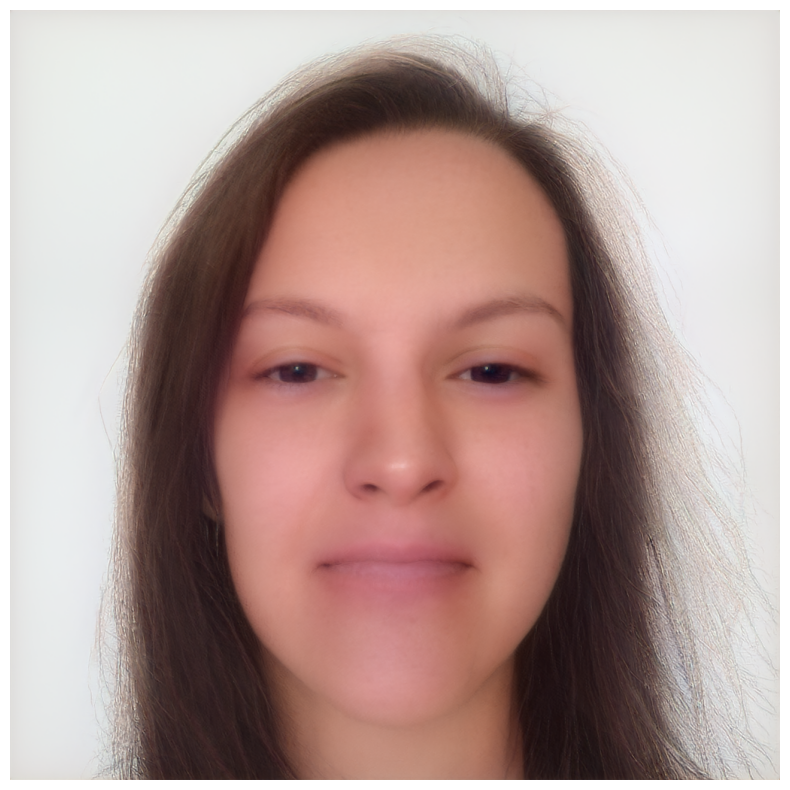

In [119]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(happy_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/happy.jpg")

In [36]:
fear_style = fit_latent(Image.open(f'{EXPRESSIONS_ROOT}/Fear.jpg').convert('RGB'))

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.82it/s]


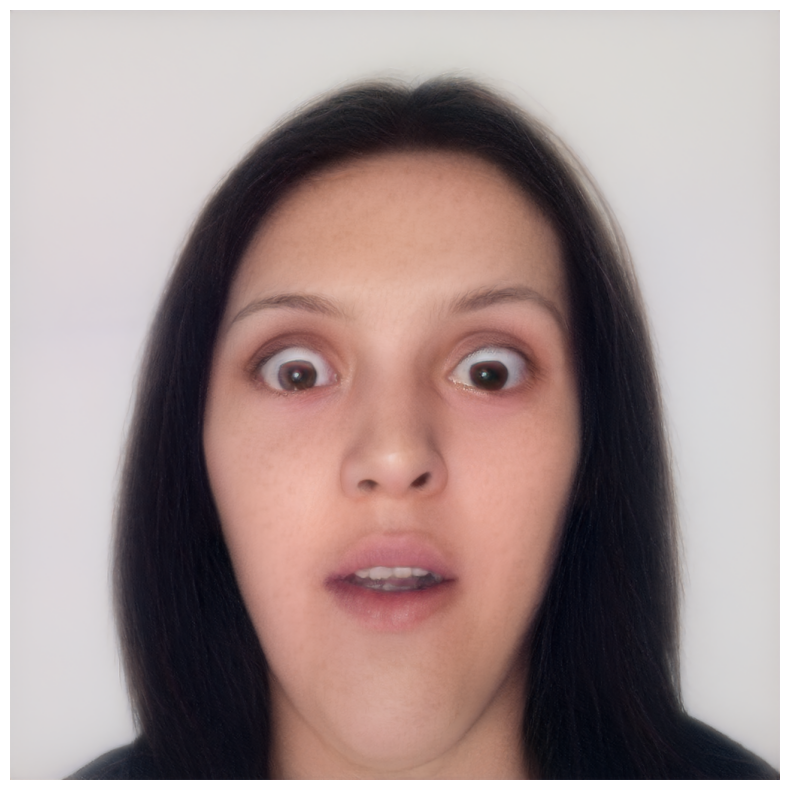

In [122]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(fear_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/fear.jpg")

In [37]:
sad_style = fit_latent(Image.open(f'{EXPRESSIONS_ROOT}/Sad.jpg').convert('RGB'))

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.82it/s]


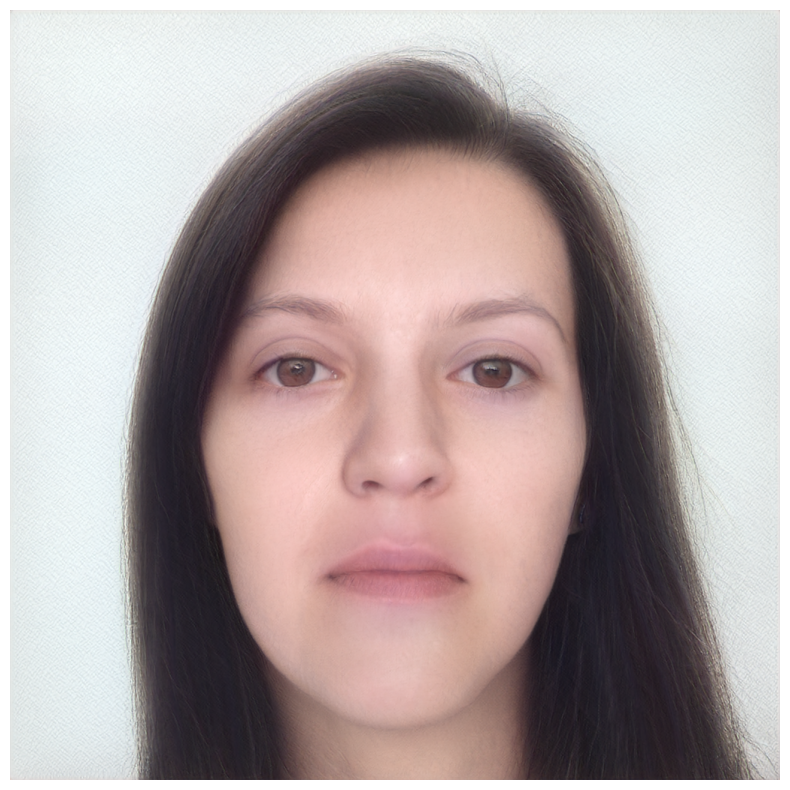

In [124]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(sad_style), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/sad.jpg")

In [38]:
fear_delta = fear_style - neutral_style
happy_delta = happy_style - neutral_style
sad_delta = sad_style - neutral_style

In [196]:
# экспериментальным путем было выяснено, что нулевой индекс отвечает за наличие очков (в совокупости с другими)

In [53]:
# plt.figure()
# plt.axis('off')
# interpolate(initial_style, 1.1 * fear_delta, 0.5, indeces=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])
# plt.savefig(f"{SAVE_ROOT}/expressions/transfered_fear_failed.jpg")

In [52]:
# plt.figure()
# plt.axis('off')
# interpolate(initial_style, 1.1 * fear_delta, 0.5, indeces=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])
# plt.savefig(f"{SAVE_ROOT}/expressions/transfered_fear_succsess.jpg")

In [275]:
# но кажется есть способ лучше

In [41]:
mask = torch.zeros((1, 18, 512))

In [42]:
# fear_mask = torch.zeros(initial_style).detech().cpu()
# sad_mask = torch.zeros_like(initial_style).detech().cpu()
# happy_mask = torch.zeros_like(initial_style).detech().cpu()

In [110]:
mask = torch.zeros((1, 18, 512))
# rng = list(np.arange(2, 18))
rng = [4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]
mask[0][rng] = torch.ones(512)

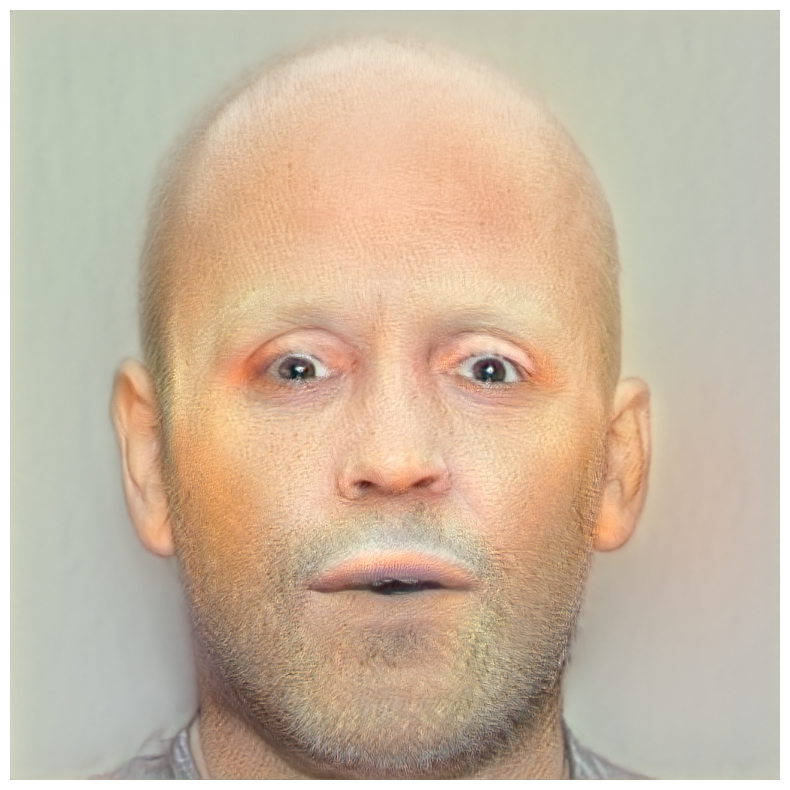

In [111]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(initial_style + 1.1 * fear_delta * mask.to('cuda')), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/transfered_fear.jpg")

In [112]:
del mask

In [121]:
mask = torch.zeros((1, 18, 512))
# rng = list(np.arange(2, 18))
rng = [0, 4, 5, 8, 13, 14]
mask[0][rng] = torch.ones(512)

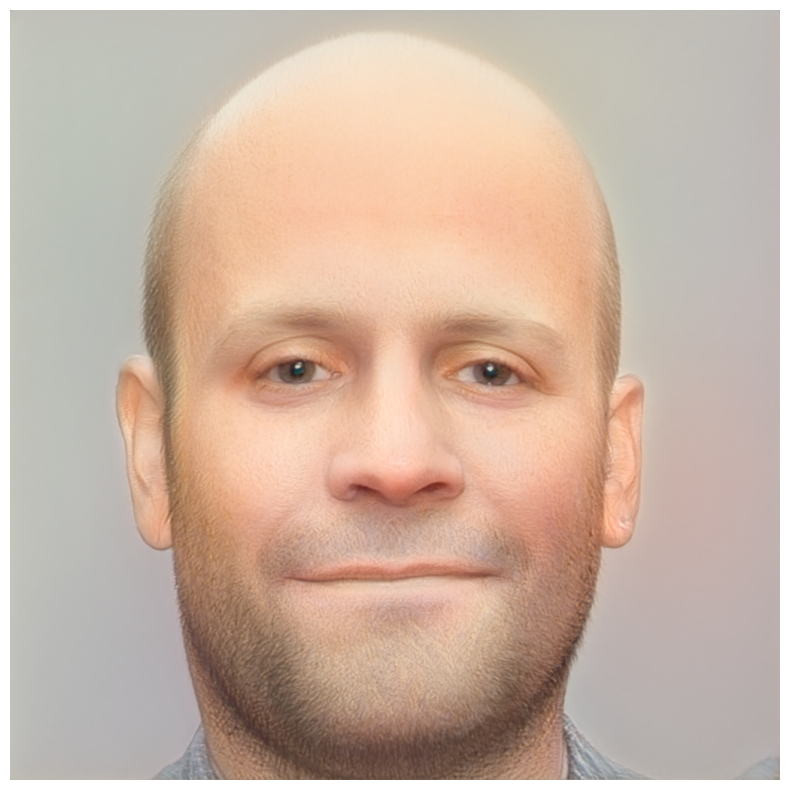

In [124]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(initial_style + 0.8 * happy_delta * mask.to('cuda')), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/transfered_happy.jpg")

In [141]:
mask = torch.zeros((1, 18, 512))
# rng = list(np.arange(2, 18))
rng = [1, 3, 4, 5, 6, 7, 8, 13, 14]
mask[0][rng] = torch.ones(512)

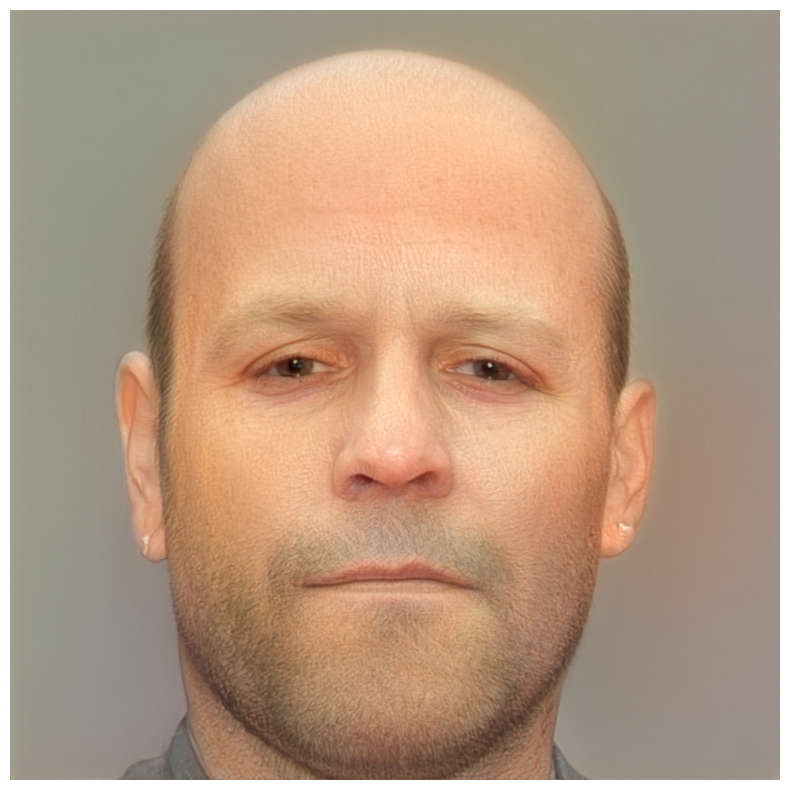

In [142]:
plt.figure()
plt.axis('off')
plot_image(G.synthesis(broadcast_w_sg(initial_style + 0.8 * sad_delta * mask.to('cuda')), noise_mode='const', force_fp32=True))
plt.savefig(f"{SAVE_ROOT}/expressions/transfered_sad.jpg")

# Face swap

In [23]:
import PIL
import os
import numpy as np
import torch
import lpips
import torch.nn as nn
import torchvision.transforms as transforms
from pytorch_msssim import ms_ssim
from stylegan2_models.arcface_model import get_model
import torch.nn.functional as F
from stylegan2_models.e4e.model_utils import load_e4e_standalone
import torchvision.transforms as transforms


def image2tensor_norm(image):
    transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    tensor = transform(image)
    return tensor



class Arcface_Loss(nn.Module):
    def __init__(self, weights_path, device):
        super().__init__()

        self.arcnet = get_model("r50", fp16=False)
        self.arcnet.load_state_dict(torch.load(weights_path))
        self.arcnet.eval()
        self.arcnet.to(device)

        self.cosin_loss = nn.CosineSimilarity(dim=1, eps=1e-6)

    def forward(self, source, synth):

        source = F.interpolate(source,size=(112,112), mode='bicubic')
        synth = F.interpolate(synth,size=(112,112), mode='bicubic')

        emb1 = self.arcnet(source)
        emb2 = self.arcnet(synth)
        loss = (1 - self.cosin_loss(emb1, emb2))[0]
        return loss

In [24]:
# # https://drive.google.com/file/d/1QIPdkYyIwqEUS8jBNouWo9eYzr3DwDd5/view?usp=sharing ссылка на загрузку весов
# arcface_path = "/kaggle/input/arcface-weights/ms1mv3_arcface_r50_fp16.pth"
# attr_path  = "/content/aligned_images/Stethem/0.jpg"
# id_path = "/content/aligned_images/AJoly/0.jpg"


# """
#   1 Взять 6 фотографии, наборе должны быть хотя бы 2 фото с разным поворотом головы
#    - Делаем style transfer
#    - Замена лиц с новым Arcface лоссом

#   2. Expression Transfer


#    # * заменить на полный кадр
#   # https://github.com/zllrunning/face-parsing.PyTorch
# """


In [25]:
arcface_path = "/kaggle/input/arcface-weights/ms1mv3_arcface_r50_fp16.pth"

In [153]:
# возьмем такой поворот головы

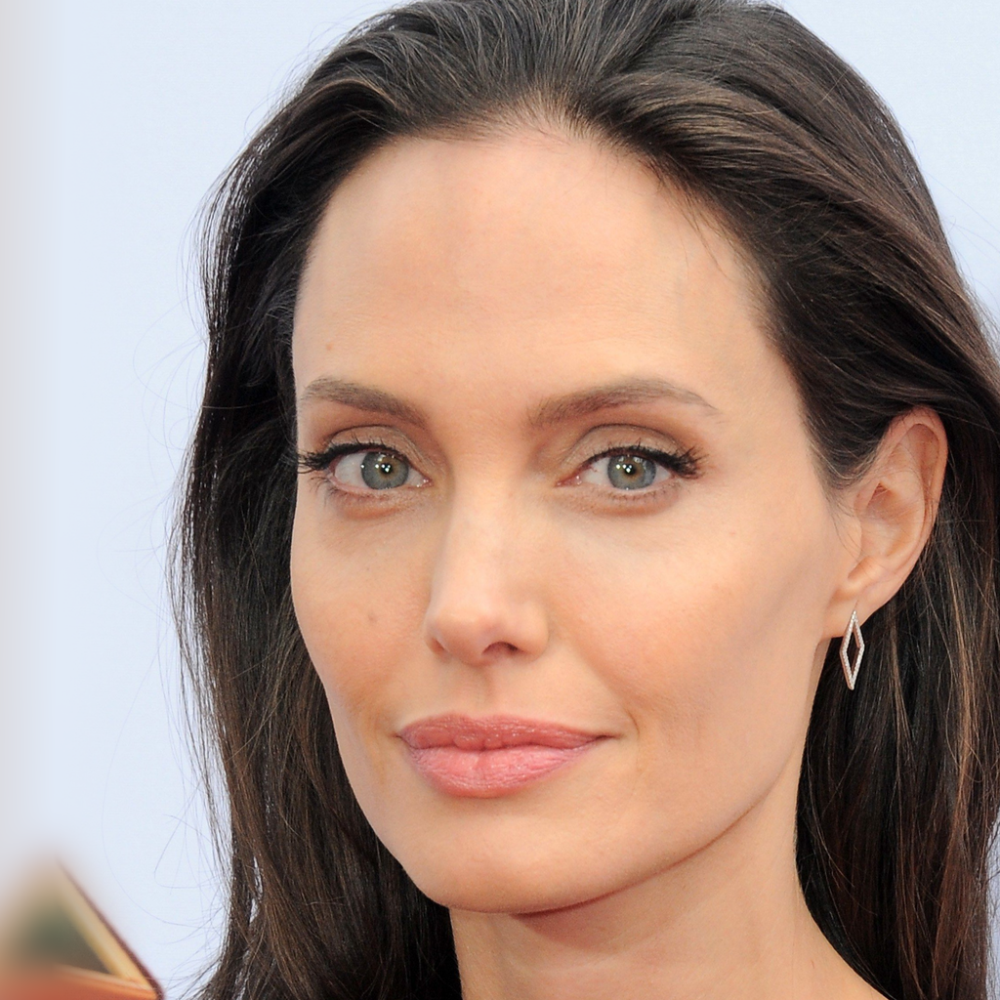

In [26]:
Image.open("/kaggle/working/aligned/AJoly/2.jpg")

In [27]:
faceswap_style = fit_latent(Image.open("/kaggle/working/aligned/AJoly/2.jpg").convert("RGB"))

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.85it/s]


In [28]:
faceswap_synth = G.synthesis(broadcast_w_sg(faceswap_style), noise_mode='const').detach()

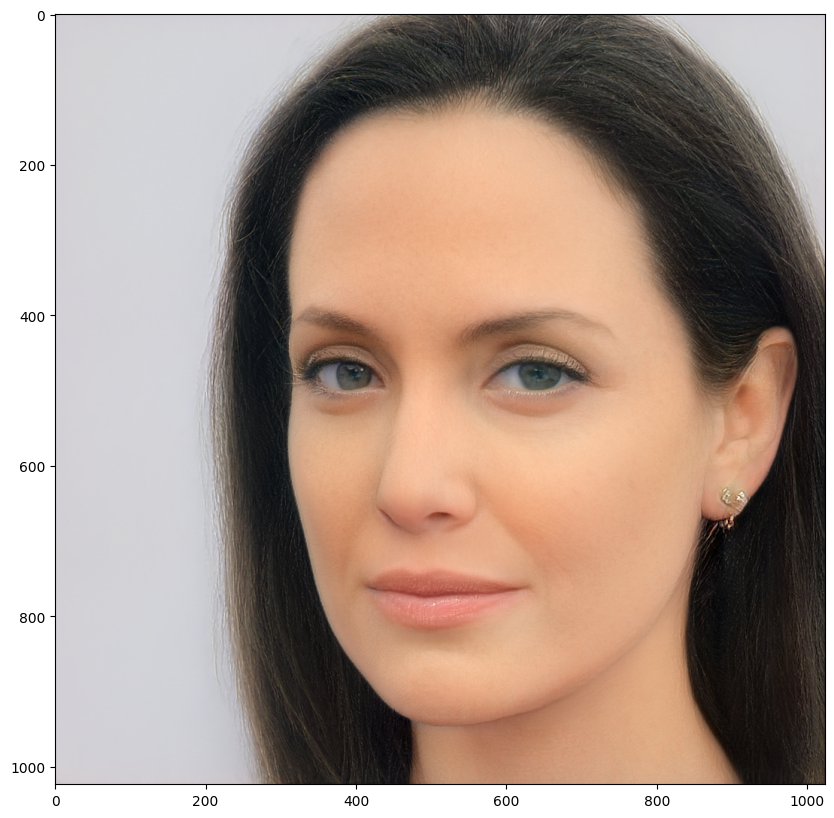

In [29]:
plot_image(faceswap_synth)

In [30]:
target_pil = Image.open('/kaggle/input/aligned-data/aligned/Stethem/3.jpg').convert('RGB')

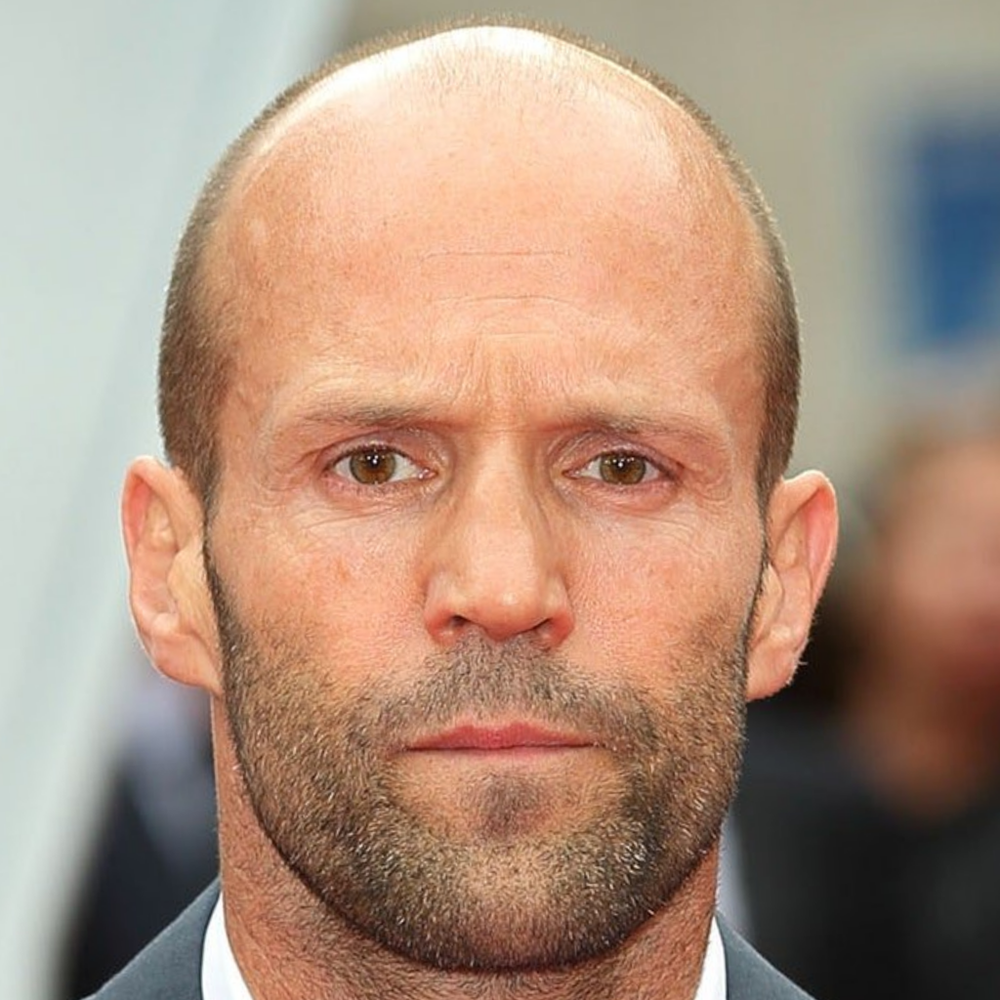

In [31]:
target_pil

In [ ]:
target_tensor = image2tensor_norm(target_pil).to(device).unsqueeze(0)


arcface_loss = Arcface_Loss(arcface_path, 'cuda')
lpips_loss = Lpips_loss(device)
rec_loss = Rec_loss()
noise_bufs = { name: buf for (name, buf) in G.synthesis.named_buffers() if 'noise_const' in name }
reg_loss = Reg_loss(noise_bufs)

In [79]:
#  loss weights
regularize_noise_weight = 5e5
rec_weight = 0.5
lpips_weight = 1
# имперически подобрал вес arcface
arc_weight = 0.5

In [75]:

# Параметры для оптимизации
num_steps = 200
seed = 42
# поменял стартовый lr
initial_learning_rate = 1e-2
w_avg_samples = 10000

In [76]:
z_samples = torch.from_numpy(np.random.RandomState(seed).randn(w_avg_samples, G.z_dim)).to(device)
w_samples = G.mapping(z_samples, None)
w_samples = w_samples[:, :1, :].cpu().numpy().astype(np.float32)
w_avg = np.mean(w_samples, axis=0, keepdims=True)   # [1, 1, C]
w_std = (np.sum((w_samples - w_avg) ** 2) / w_avg_samples) ** 0.5

w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=False) # pylint: disable=not-callable
w_opt = broadcast_w_sg(w_opt).requires_grad_(True)


optimizer = torch.optim.AdamW([w_opt], lr=initial_learning_rate)
# добавил шедулер
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.99)


generated_tensors = []

synth_tensors = []
losses = []
for step in tqdm(range(num_steps)):
    synth_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const')
    synth_tensors.append(synth_tensor)
    lpips_value = lpips_loss(synth_tensor, target_tensor)
    rec_value = rec_loss(synth_tensor, target_tensor)
    reg_value = reg_loss()
    
    arc_value = arcface_loss(synth_tensor, faceswap_synth)

    loss = lpips_value*lpips_weight + rec_value*rec_weight + reg_value*regularize_noise_weight  + arc_value*arc_weight
    optimizer.step()
    optimizer.zero_grad(set_to_none=True)
    loss.backward()
    scheduler.step()
    
    losses.append(loss.detach().cpu())


100%|██████████| 200/200 [01:21<00:00,  2.47it/s]


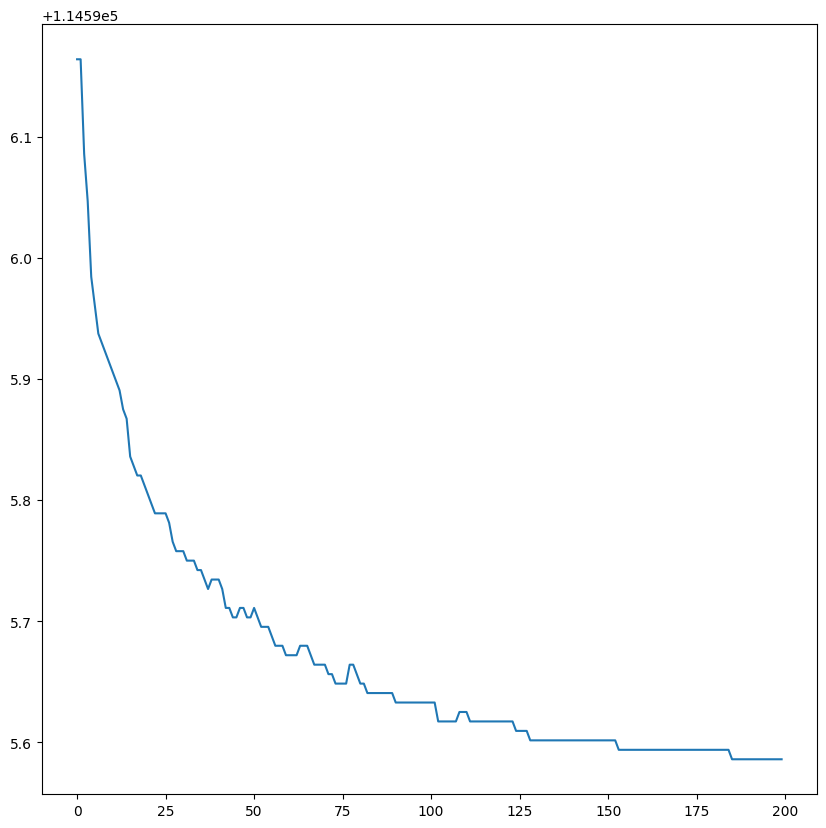

In [77]:
plt.plot(losses)

In [80]:
!mkdir /kaggle/working/out/face_swap

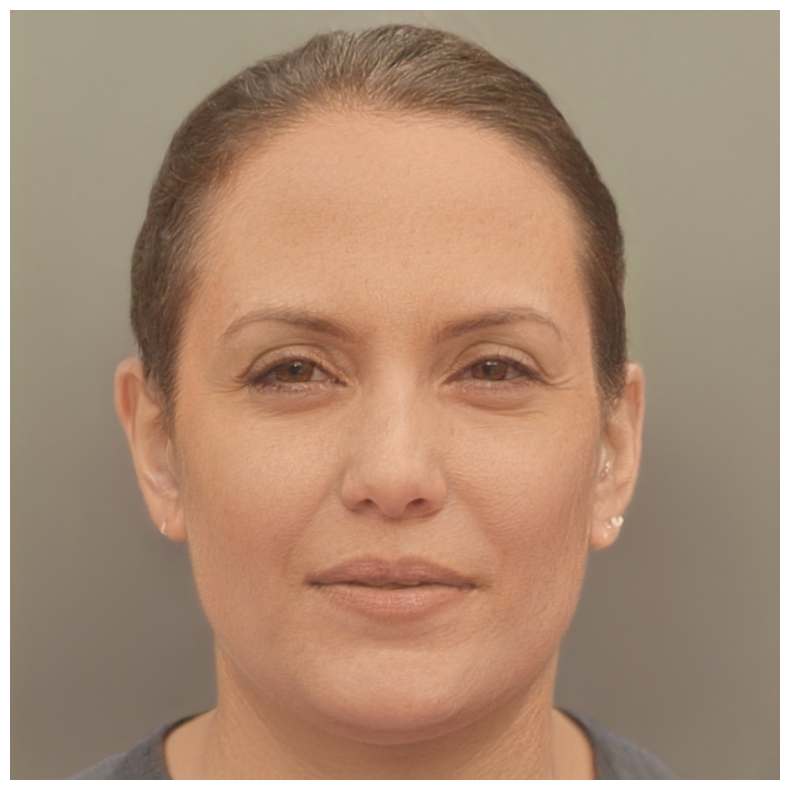

In [81]:
plt.figure()
plt.axis('off')
plot_image(synth_tensors[-1])
plt.savefig(f"{SAVE_ROOT}/face_swap/Joly_on_Statham.jpg")

In [173]:
def fit_faceswap(target_pil, faceswap_synth):
    target_tensor = image2tensor_norm(target_pil).to(device).unsqueeze(0)

    arcface_loss = Arcface_Loss(arcface_path, 'cuda')
    lpips_loss = Lpips_loss(device)
    rec_loss = Rec_loss()
    noise_bufs = { name: buf for (name, buf) in G.synthesis.named_buffers() if 'noise_const' in name }
    reg_loss = Reg_loss(noise_bufs)

    
    #  loss weights
    regularize_noise_weight = 5e5
    rec_weight = 0.5
    lpips_weight = 1
    # имперически подобрал вес arcface
    arc_weight = 0.5


    # Параметры для оптимизации
    num_steps = 250
    seed = 42
    # поменял стартовый lr
    initial_learning_rate = 1e-2
    w_avg_samples = 10000

    z_samples = torch.from_numpy(np.random.RandomState(seed).randn(w_avg_samples, G.z_dim)).to(device)
    w_samples = G.mapping(z_samples, None)
    w_samples = w_samples[:, :1, :].cpu().numpy().astype(np.float32)
    w_avg = np.mean(w_samples, axis=0, keepdims=True)   # [1, 1, C]
    w_std = (np.sum((w_samples - w_avg) ** 2) / w_avg_samples) ** 0.5

    w_opt = torch.tensor(w_avg, dtype=torch.float32, device=device, requires_grad=False) # pylint: disable=not-callable
    w_opt = broadcast_w_sg(w_opt).requires_grad_(True)


    optimizer = torch.optim.AdamW([w_opt], lr=initial_learning_rate)
    # добавил шедулер
    scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)


    generated_tensors = []

    synth_tensors = []
    losses = []
    for step in tqdm(range(num_steps)):
        synth_tensor = G.synthesis(broadcast_w_sg(w_opt), noise_mode='const')
        synth_tensors.append(synth_tensor)
        lpips_value = lpips_loss(synth_tensor, target_tensor)
        rec_value = rec_loss(synth_tensor, target_tensor)
        reg_value = reg_loss()

        arc_value = arcface_loss(synth_tensor, faceswap_synth)

        loss = lpips_value*lpips_weight + rec_value*rec_weight + reg_value*regularize_noise_weight  + arc_value*arc_weight
        optimizer.step()
        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        scheduler.step()

        losses.append(loss.detach().cpu())

    return synth_tensor, losses


In [174]:
glob('/kaggle/input/aligned-data/aligned/*')

['/kaggle/input/aligned-data/aligned/Stethem',
 '/kaggle/input/aligned-data/aligned/KJunJin',
 '/kaggle/input/aligned-data/aligned/AJoly',
 '/kaggle/input/aligned-data/aligned/EMerphy',
 '/kaggle/input/aligned-data/aligned/LDCaprio',
 '/kaggle/input/aligned-data/aligned/expressions']

In [91]:
CELEBS_ROOT = "/kaggle/input/aligned-data/aligned/"
CELEBS = ['EMerphy', 'Stethem', 'AJoly', 'KJunJin', 'LDCaprio']
SYNTH_CELEBS = {}

for celeb in CELEBS:
    latent = fit_latent(Image.open(f"{CELEBS_ROOT}/{celeb}/0.jpg"))
    SYNTH_CELEBS[celeb] = G.synthesis(broadcast_w_sg(latent), noise_mode='const').detach()

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.84it/s]
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.84it/s]
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.83it/s]
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.83it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 120/120 [00:42<00:00,  2.83it/s]


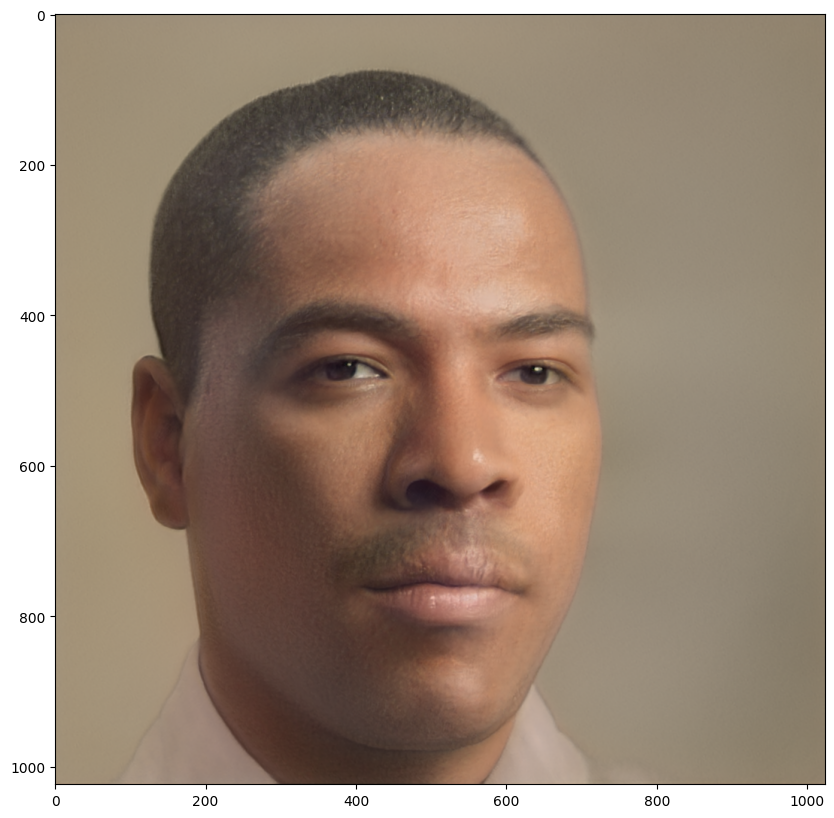

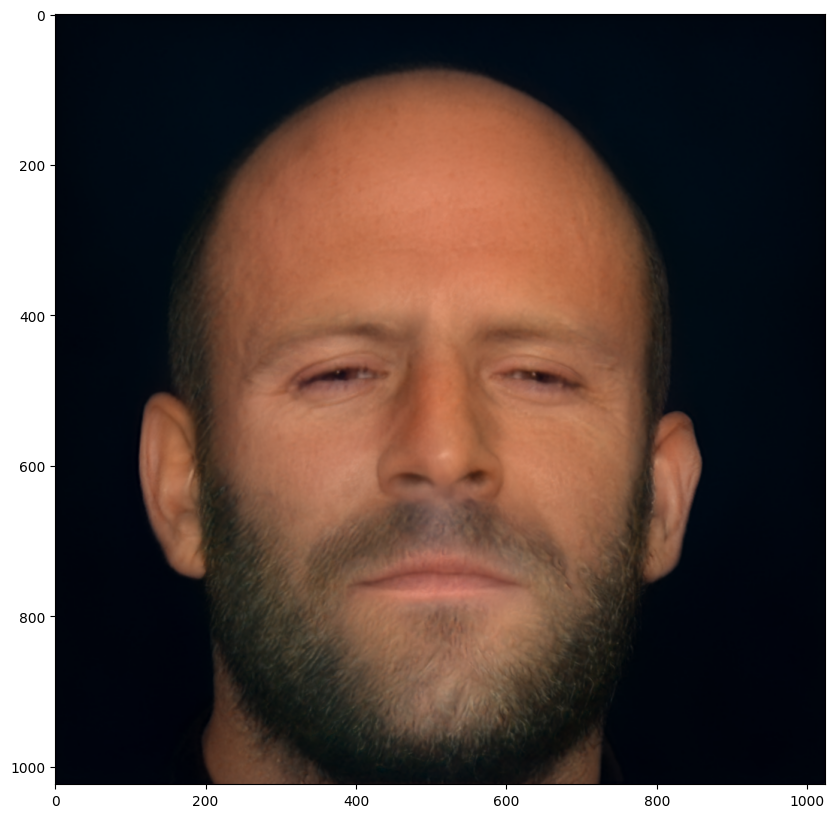

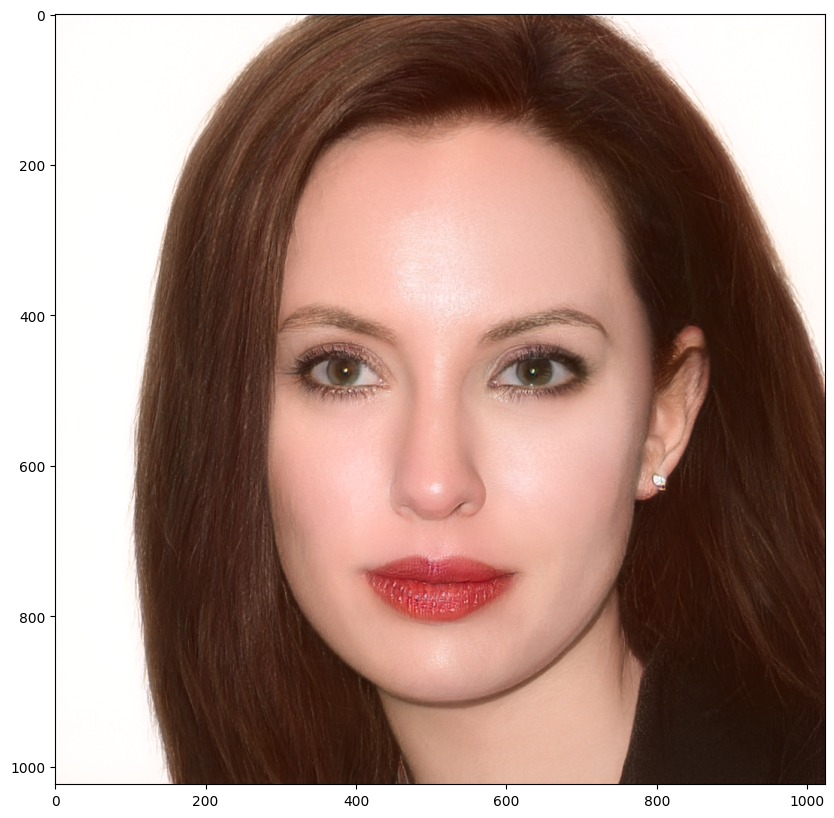

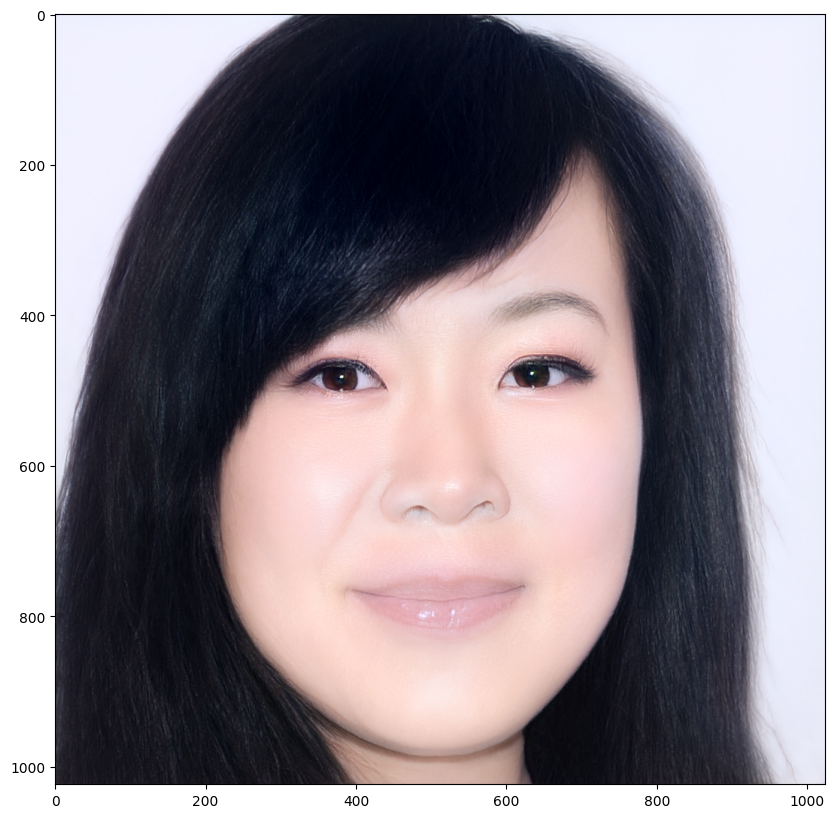

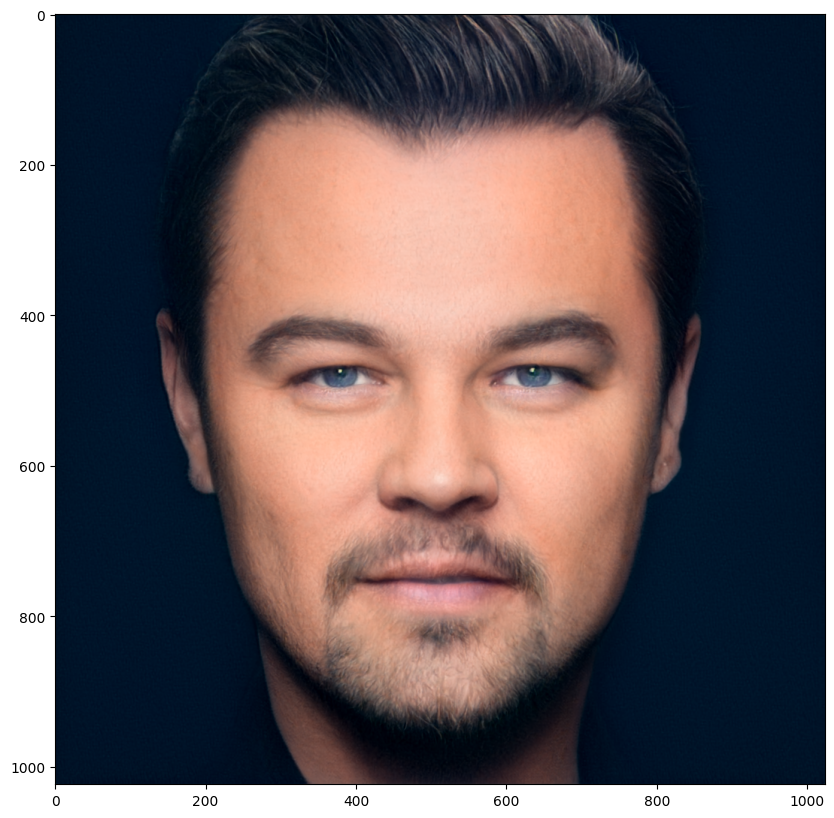

In [93]:
for celeb in CELEBS:
    plt.figure()
    plot_image(SYNTH_CELEBS[celeb])
    plt.plot()

In [175]:
FACESWAP_CELEBS = {}

In [176]:
from time import sleep

In [149]:
sleep(1)

In [150]:
for celeb_a in CELEBS:
    for celeb_b in CELEBS:
        if celeb_a == celeb_b:
            continue
        swapped_face =  fit_faceswap(Image.open(f"{CELEBS_ROOT}/{celeb_a}/0.jpg"), SYNTH_CELEBS[celeb_b])
        FACESWAP_CELEBS[(celeb_a, celeb_b)] = swapped_face
        sleep(5)
#         break
#     break

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:21<00:00,  2.45it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:21<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:21<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.42it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.42it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.42it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.43it/s]


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.42it/s]


In [155]:
celeb_a = 'LDCaprio'
celeb_b = 'AJoly'

In [156]:
swapped_face =  fit_faceswap(Image.open(f"{CELEBS_ROOT}/{celeb_a}/0.jpg"), SYNTH_CELEBS[celeb_b])

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 200/200 [01:22<00:00,  2.44it/s]


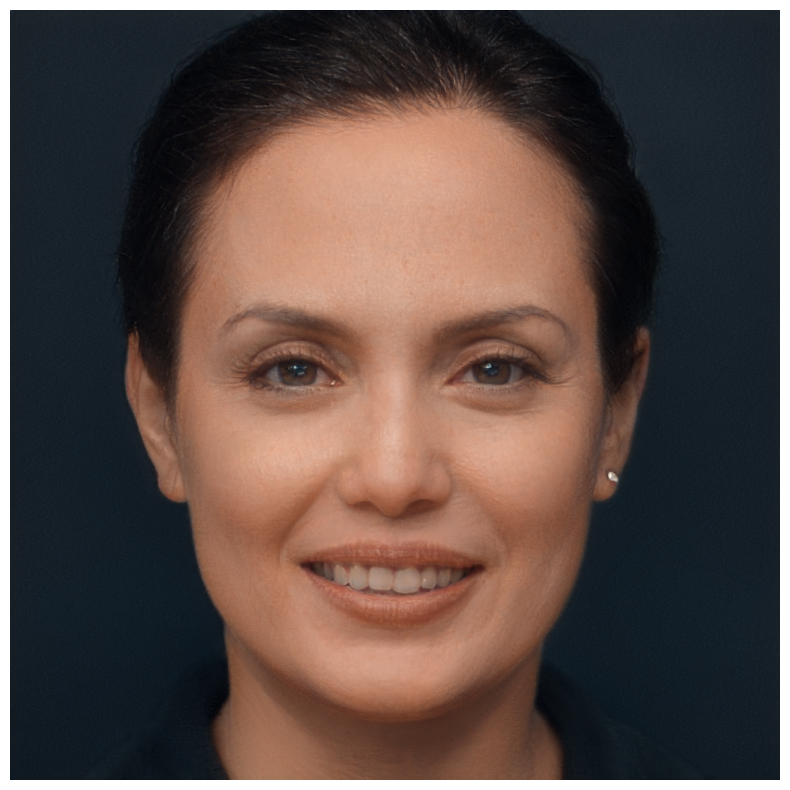

In [158]:
plt.figure()
plt.axis('off')
plot_image(swapped_face)
plt.savefig(f"{SAVE_ROOT}/face_swap/{celeb_b}_on_{celeb_a}.jpg")

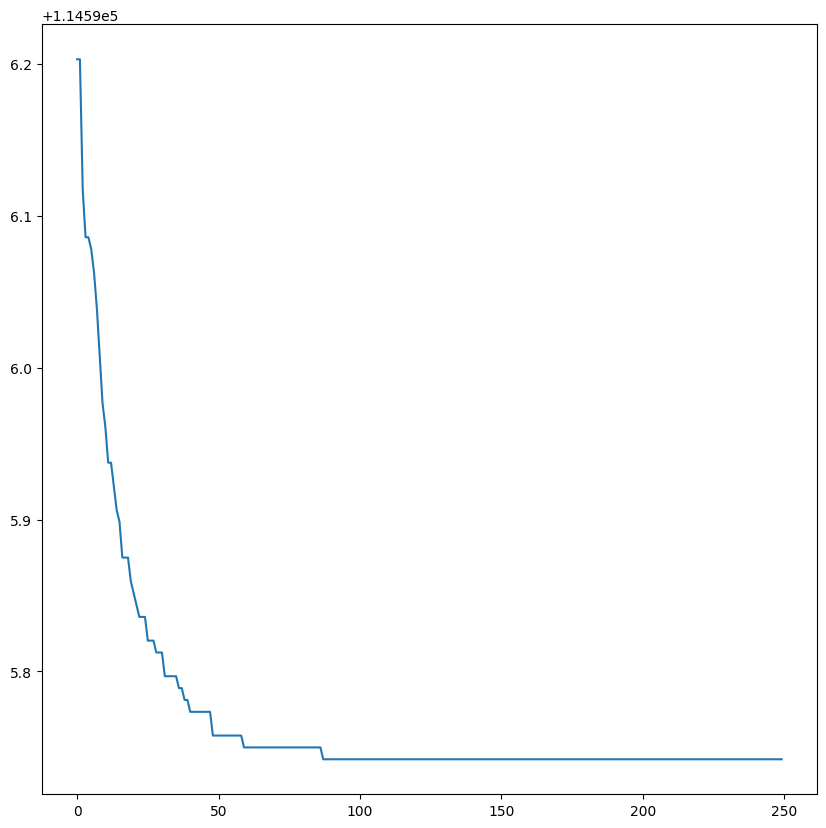

In [179]:
plt.plot(losses)

In [177]:
celeb_a = "LDCaprio"
celeb_b = "Stethem"
swapped_face, losses =  fit_faceswap(Image.open(f"{CELEBS_ROOT}/{celeb_a}/0.jpg"), SYNTH_CELEBS[celeb_b])

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 250/250 [01:42<00:00,  2.45it/s]


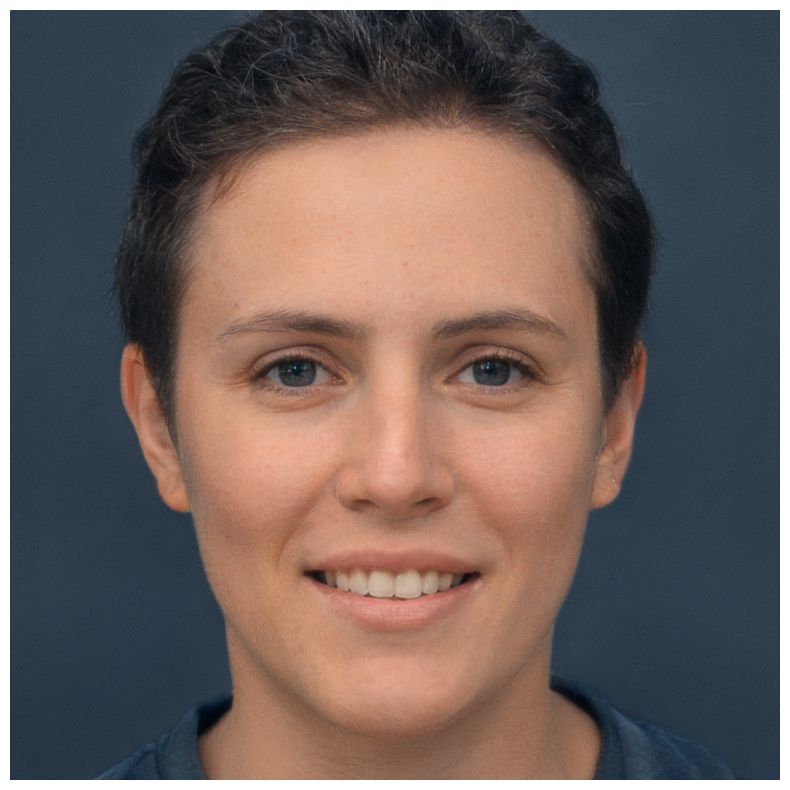

In [178]:
plt.figure()
plt.axis('off')
plot_image(swapped_face)
plt.savefig(f"{SAVE_ROOT}/face_swap/{celeb_b}_on_{celeb_a}.jpg")

In [170]:
celeb_a = "LDCaprio"
celeb_b = "Stethem"
swapped_face =  fit_faceswap(Image.open(f"{CELEBS_ROOT}/{celeb_a}/0.jpg"), SYNTH_CELEBS[celeb_b])


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


100%|██████████| 250/250 [01:42<00:00,  2.43it/s]


In [ ]:
plt.figure()
plt.axis('off')
plot_image(swapped_face)
plt.savefig(f"{SAVE_ROOT}/face_swap/{celeb_b}_on_{celeb_a}.jpg")

In [180]:
num_celebs = len(CELEBS)

fig, axs = plt.subplots(num_celebs, num_celebs, figsize=(15, 15))

for i, celeb_a in enumerate(CELEBS):
    for j, celeb_b in enumerate(CELEBS):
        if i == j:
            img_path = f"{CELEBS_ROOT}/{celeb_a}/0.jpg"
            img = Image.open(img_path)
        else:
            tensor = FACESWAP_CELEBS[(celeb_a, celeb_b)]
            tensor = (tensor.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
            img = Image.fromarray(tensor[0].cpu().numpy(), 'RGB')
            
        axs[i, j].axis('off')
        axs[i, j].imshow(img)
plt.show()

In [33]:
# import imageio

# def save_video(generated_tensors, video_path):
#     video = imageio.get_writer(video_path, mode='I', fps=10, codec='libx264', bitrate='16M')
#     target_uint8 = np.array(target_pil, dtype=np.uint8)
#     print (f'Saving optimization progress video {video_path}')
#     for synth_image in generated_tensors:
#         synth_image = (synth_image + 1) * (255/2)
#         synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()
#         video.append_data(np.concatenate([target_uint8, synth_image], axis=1))
#     video.close()
#     print('SAVED!')

# video_path = "/kaggle/working/faceswap.mp4"
# save_video(synth_tensors, video_path)

In [182]:
!zip -r /kaggle/working/out.zip /kaggle/working/out

updating: kaggle/working/out/expressions/ (stored 0%)
updating: kaggle/working/out/expressions/transfered_happy.jpg (deflated 31%)
updating: kaggle/working/out/expressions/neutral.jpg (deflated 16%)
updating: kaggle/working/out/expressions/transfered_fear_failed.jpg (deflated 31%)
updating: kaggle/working/out/expressions/sad.jpg (deflated 11%)
updating: kaggle/working/out/expressions/transfered_sad.jpg (deflated 13%)
updating: kaggle/working/out/expressions/happy.jpg (deflated 14%)
updating: kaggle/working/out/expressions/transfered_fear_succsess.jpg (deflated 32%)
updating: kaggle/working/out/expressions/fear.jpg (deflated 19%)
updating: kaggle/working/out/expressions/transfered_fear.jpg (deflated 16%)
updating: kaggle/working/out/init_style.jpg (deflated 16%)
updating: kaggle/working/out/styles/ (stored 0%)
updating: kaggle/working/out/styles/transfered_green.jpg (deflated 31%)
updating: kaggle/working/out/styles/transfered_pink.jpg (deflated 32%)
updating: kaggle/working/out/styles/